<a href="https://colab.research.google.com/github/DaruHashida/MyPyTorch/blob/main/Pytorch_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 02. Neural Network classification with Pytorch
  Classification is a problem of predicting whether something is some thing or another (there can be multiple things as the option)

In [1]:
import sklearn

In [2]:
from sklearn.datasets import make_circles

#Make 1000 samples
n_samples = 1000

#Create circles
X, y = make_circles(n_samples,
                    noise=0.03,
                    random_state=42)

In [3]:
len(X), len(y
            )

(1000, 1000)

In [4]:
print (f"First 5 samples of X:\n {X[:5]}")
print (f"First 5 samples of y:\n {y[:5]}")

First 5 samples of X:
 [[ 0.75424625  0.23148074]
 [-0.75615888  0.15325888]
 [-0.81539193  0.17328203]
 [-0.39373073  0.69288277]
 [ 0.44220765 -0.89672343]]
First 5 samples of y:
 [1 1 1 1 0]


In [5]:
# Make DataFrame of circle data
import pandas as pd
circles = pd.DataFrame({"X1": X[:, 0],
                        "X2": X[:, 1],
                       "label": y})
circles.head(10)

,X1,X2,label
0,0.754246,0.231481,1
1,-0.756159,0.153259,1
2,-0.815392,0.173282,1
3,-0.393731,0.692883,1
4,0.442208,-0.896723,0
5,-0.479646,0.676435,1
6,-0.013648,0.803349,1
7,0.771513,0.147760,1
8,-0.169322,-0.793456,1
9,-0.121486,1.021509,0


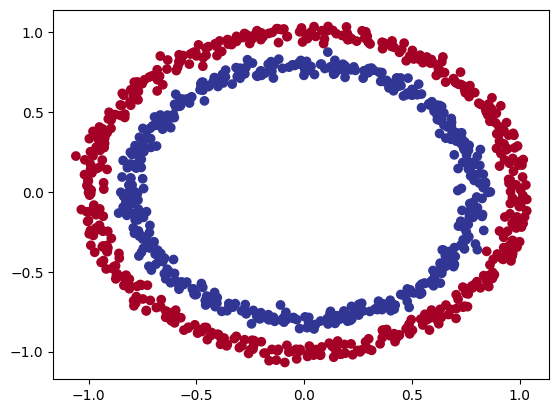

In [6]:
#Visualize. visualize, visualize
import matplotlib.pyplot as plt
plt.scatter(x=X[:, 0],
            y=X[:, 1],
            c=y,
            cmap=plt.cm.RdYlBu)

### 1.1. Check input and output shapes

In [7]:
X.shape, y.shape


((1000, 2), (1000,))

In [8]:
#View the first example of features and labels
X_sample = X[0]
y_sample = y[0]

print (f"Values for one sample of X: {X_sample} and the same for y:{y_sample}")
print (f"Shapes for one sample of X: {X_sample.shape} and the same for y {y_sample.shape}")

Values for one sample of X: [0.75424625 0.23148074] and the same for y:1
Shapes for one sample of X: (2,) and the same for y ()




###1,2, Turn data into tensors and create train and test splits

In [9]:
#Turn data into tensors
import torch
torch.__version__

'2.3.0+cu121'

In [10]:
X.dtype

dtype('float64')

In [11]:
#Turn data into tensors
X=torch.from_numpy(X).type(torch.float)
y=torch.from_numpy(y).type(torch.float)

X[:5], y[:5]

(tensor([[ 0.7542,  0.2315],
         [-0.7562,  0.1533],
         [-0.8154,  0.1733],
         [-0.3937,  0.6929],
         [ 0.4422, -0.8967]]),
 tensor([1., 1., 1., 1., 0.]))

In [12]:
X.dtype, y.dtype

(torch.float32, torch.float32)

In [13]:
#Split data into training and test sets
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size=0.2,
                                                    random_state=42)

In [14]:
len(X_train), len(X_test), len(y_train), len(y_test)

(800, 200, 800, 200)

##2. Building a model

Let's build a model to classify our blue and red dots
To do so, we want to:
1. Setup device agnostic code so our code will run on an accelerator if there is one
2. Construct a module (by subclassing nn.Module)
3. Define a loss function and optimizer
4. Create a training and test loop

In [15]:
#Import PyTorch and nn
import torch
from torch import nn

#Make device agnostic code

device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

Now we've setup device agnostic code, let's create some

1. Subclasses `nn.Module` (almost all models in PyTorch subclasses `nn.Module`)
2. Create 2 `nn.Linear()` layers that are capable of handling the shapes of our data
3. Defines a `forward()` method that outlines the forward pass (or forward computation of the model)
4. Instantiate an instance of our model class and send it to the target

In [16]:
X_train.shape


torch.Size([800, 2])

In [17]:
#1. Construct a model that subclasses nn.Module
class CircleModelV0(nn.Module):
  def __init__(self):
    super().__init__()
    #2. Create 2 nn.Linear layers capable of handling the shapesof our data
    self.layer_1=nn.Linear(in_features=2, out_features=5)#Takes in 2 features and upscales to 5 features
    self.layer_2=nn.Linear(in_features=5, out_features=1)#Takes in 5 features from previous linear and convert it to 1
  #Define a forward method that outlines the forward pass
  def forward(self,x):
    return self.layer_2(self.layer_1(x))#x->layer_1->layer_2->output
#4. Instantiate an instanceof our model class and send it to the target device
model_0=CircleModelV0().to(device)
model_0


CircleModelV0(
  (layer_1): Linear(in_features=2, out_features=5, bias=True)
  (layer_2): Linear(in_features=5, out_features=1, bias=True)
)

In [18]:
device

'cuda'

In [19]:
next(model_0.parameters()).device

device(type='cuda', index=0)

In [20]:
#Let's replicate the model above using nn.Sequential()
model_0=nn.Sequential(
    nn.Linear(in_features=2, out_features=128),
    nn.ReLU(),
    nn.Linear(in_features=128, out_features=256),
    nn.Linear(in_features=256, out_features=128),
    nn.Linear(in_features=128, out_features=1),
).to(device)
model_0

Sequential(
  (0): Linear(in_features=2, out_features=128, bias=True)
  (1): ReLU()
  (2): Linear(in_features=128, out_features=256, bias=True)
  (3): Linear(in_features=256, out_features=128, bias=True)
  (4): Linear(in_features=128, out_features=1, bias=True)
)

In [21]:
model_0.state_dict()


OrderedDict([('0.weight',
              tensor([[-1.8816e-01,  2.9060e-02],
                      [-3.9330e-01,  1.0106e-01],
                      [ 4.7279e-01, -2.3356e-01],
                      [ 4.8687e-01,  5.1022e-01],
                      [-6.5199e-01, -1.8962e-01],
                      [-3.7331e-01, -4.8621e-04],
                      [ 5.9514e-01,  5.3645e-01],
                      [ 6.9010e-01, -3.5903e-01],
                      [ 4.6108e-01,  5.4490e-01],
                      [-1.3435e-01, -5.1441e-01],
                      [-2.2962e-01, -1.2414e-01],
                      [-4.8260e-01,  1.1434e-01],
                      [-4.8350e-01,  6.3210e-01],
                      [ 4.7873e-01,  2.7259e-01],
                      [-2.6093e-01,  6.8001e-01],
                      [ 1.3516e-01,  4.7793e-02],
                      [-1.8398e-01,  2.3848e-01],
                      [ 4.4667e-01, -4.7330e-01],
                      [ 1.3674e-01,  5.7100e-01],
                      [ 

In [22]:
with torch.inference_mode():
  untrained_preds=model_0(X_test.to(device))
print(f"Length of predictions: {len(untrained_preds)}, Shape: {untrained_preds.shape}")
print(f"Length of test samples: {len(X_test)}, Shape: {X_test.shape}")
print(f"\n First 10 preditions:\n {untrained_preds[:10]}")
print(f"\n First 10 labels:\n {y_test[:10]}")

Length of predictions: 200, Shape: torch.Size([200, 1])
Length of test samples: 200, Shape: torch.Size([200, 2])

 First 10 preditions:
 tensor([[-0.0161],
        [-0.0604],
        [ 0.0674],
        [-0.0411],
        [ 0.0060],
        [-0.0219],
        [-0.0663],
        [-0.0694],
        [ 0.0688],
        [-0.0628]], device='cuda:0')

 First 10 labels:
 tensor([1., 0., 1., 0., 1., 1., 0., 0., 1., 0.])


### 2.1. Setup loss function and optimizer
Which loss function or oprimizer should use?

Again... this is problem specific.
For example for regression you might want MAE or MSE (mean absolute error or mean squared error)

For classification: binary cross entropy or categorical cross entropy (cross entropy).

As a reminder, the loss function measures how *wrong*your models predictions are

And for optimizers, two of the most common and useful are SGD and Adam, however PyTorch has many built-in options.

*For the loss funtion we're going to use `torch.nn.BCEWithLogitsLoss()`



In [23]:
#Setup the loss function
#loss_fn= nn.BCELoss() #BCELoss = requires inputs to have gone through the sigmoid activation function prior to input to BCE loss
loss_fn = nn.BCEWithLogitsLoss() #BCEWithLogitsLoss = sigmoid activation funtion built in

optimizer = torch.optim.SGD (params=model_0.parameters(),
                             lr=0.1)

In [24]:
#Calculate accuracy - outof 100 examples, what percentage our model get right
def accuracy_fn(y_true,y_pred):
  correct = torch.eq(y_true, y_pred).sum().item()
  acc = (correct/len(y_pred))*100
  return acc

##3. Train model

To train our model, we're going to need to build a training loop:

1. Forward pass
2. Calculate loss
3. Optimizer zero grad
4. Loss backward (backpropragation)
5. Optimizer step (gradient descent)

### 3.1. Going from raw logits -> prediction probabilities -> prediction labels

Our model outputs are going to be raw **logits**
We can convert these **logits** into prediction probabilities by passing them to some kind of activation function (e.g.sigmoid for binary cross entropy and softmax for multiclass classification)

Then we can onvert our model's prediction probabilities to **prediction labels** by either rounding them or taking the `argmax()`

In [25]:
#View the first 5 outputs ofthe forward pass on the test data
with torch.inference_mode():
  y_logits = model_0(X_test.to(device))[:5]
y_logits

tensor([[-0.0161],
        [-0.0604],
        [ 0.0674],
        [-0.0411],
        [ 0.0060]], device='cuda:0')

In [26]:
#Use the sigmoid activation function on our modal logits to turn them into prediction probabilities
y_pred_probs=torch.sigmoid(y_logits)
y_pred_probs

tensor([[0.4960],
        [0.4849],
        [0.5168],
        [0.4897],
        [0.5015]], device='cuda:0')

In [27]:
torch.round(y_pred_probs)

tensor([[0.],
        [0.],
        [1.],
        [0.],
        [1.]], device='cuda:0')

In [28]:
 model_0

Sequential(
  (0): Linear(in_features=2, out_features=128, bias=True)
  (1): ReLU()
  (2): Linear(in_features=128, out_features=256, bias=True)
  (3): Linear(in_features=256, out_features=128, bias=True)
  (4): Linear(in_features=128, out_features=1, bias=True)
)

For our prediction probability values, we need to perform a range-style rounding on them:
* `y_pred_probs` >= 0.5, `y=1`(class 1)
* `y_pred_probs`< 0.5, `y=0`(class 0)

In [29]:
#Find the predicted labels
y_preds = torch.round(y_pred_probs)
#In full
y_pred_labels = torch.round(torch.sigmoid(model_0(X_test.to(device))[:5]))

#Check for equality
print(torch.eq(y_preds.squeeze(), y_pred_labels.squeeze()))

#Get rid of extra dimensions
y_preds.squeeze()

tensor([True, True, True, True, True], device='cuda:0')


tensor([0., 0., 1., 0., 1.], device='cuda:0')

In [30]:
torch.manual_seed(42)
torch.cuda.manual_seed(42)

#Set the number of epochs
epochs = 400

#Put the data to the target device
X_train, y_train = X_train.to(device), y_train.to(device)
X_test, y_test = X_test.to(device), y_test.to(device)

#Build training and evaluation loop
for epoch in range(epochs):
  ###Training
  model_0.train()
  #1 Forward pass
  y_logits = model_0(X_train).squeeze()
  y_pred = torch.round(torch.sigmoid(y_logits))#Going from raw logits -> prediction probabilities -> prediction labels

  #2. Calculate loss/accuracy
  loss=loss_fn(y_logits, ## nn.BCEWithLogitsLoss expects raw logits as input
               y_train)
  acc=accuracy_fn(y_true=y_train,
                  y_pred=y_pred)

  #3. Optimizer zero grad
  optimizer.zero_grad()

  # 4. Loss backward (backpropagation)
  loss.backward()

  #5. Optimizer step (gradient descent)
  optimizer.step()

  model_0.eval()
  with torch.inference_mode():
    # 1. Forward pass
    test_logits = model_0(X_test).squeeze()
    test_pred =  torch.round(torch.sigmoid(test_logits))

    #2. Calculate test loss/accuracy
    test_loss = loss_fn(test_logits,
                        y_test)
    test_acc = accuracy_fn(y_true=y_test,
                          y_pred=test_pred)
  #Print out what's happenin'
  if  epoch % 10 ==0:
    print(f"Epoch: {epoch} | Loss: {loss:.5f}, Acc: {acc:.2f}% | Test loss: {test_loss:.5f}, Test acc: {test_acc:.2f}%")


Epoch: 0 | Loss: 0.69437, Acc: 49.50% | Test loss: 0.69193, Test acc: 53.00%
Epoch: 10 | Loss: 0.69173, Acc: 51.50% | Test loss: 0.69063, Test acc: 56.50%
Epoch: 20 | Loss: 0.68944, Acc: 51.25% | Test loss: 0.68933, Test acc: 51.00%
Epoch: 30 | Loss: 0.68717, Acc: 50.00% | Test loss: 0.68787, Test acc: 50.00%
Epoch: 40 | Loss: 0.68480, Acc: 51.50% | Test loss: 0.68620, Test acc: 51.50%
Epoch: 50 | Loss: 0.68226, Acc: 60.50% | Test loss: 0.68427, Test acc: 60.50%
Epoch: 60 | Loss: 0.67945, Acc: 67.75% | Test loss: 0.68205, Test acc: 68.50%
Epoch: 70 | Loss: 0.67627, Acc: 69.62% | Test loss: 0.67944, Test acc: 69.50%
Epoch: 80 | Loss: 0.67261, Acc: 71.12% | Test loss: 0.67638, Test acc: 73.00%
Epoch: 90 | Loss: 0.66832, Acc: 73.88% | Test loss: 0.67274, Test acc: 74.50%
Epoch: 100 | Loss: 0.66323, Acc: 78.00% | Test loss: 0.66837, Test acc: 79.00%
Epoch: 110 | Loss: 0.65711, Acc: 83.75% | Test loss: 0.66307, Test acc: 81.50%
Epoch: 120 | Loss: 0.64964, Acc: 89.00% | Test loss: 0.65657, T

## 4. Make predictions and evaluate the model

From the metrics it looks like our model isn't learning anything...
So to inspect it let's make some predictions and make them visual:

In other words "Viualize, Visualize, Visualize"

To do so, we're going to import function `plot_decision_boundary()` - https://github.com/mrdbourke/pytorch-deep-learning/blob/main/helper_functions.py`

In [31]:
import requests
from pathlib import Path

#Download helper functions from Learn PyTorch repo (if it's not already downloaded)
if Path("helper_functions.py").is_file():
  print("helper_functions.py already exists, skipping download")
else:
  print("Download helper_functions.py")
  request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/helper_functions.py")
  with open("helper_functions.py", "wb") as f:
    f.write(request.content)


Download helper_functions.py


In [32]:
from helper_functions import plot_predictions, plot_decision_boundary

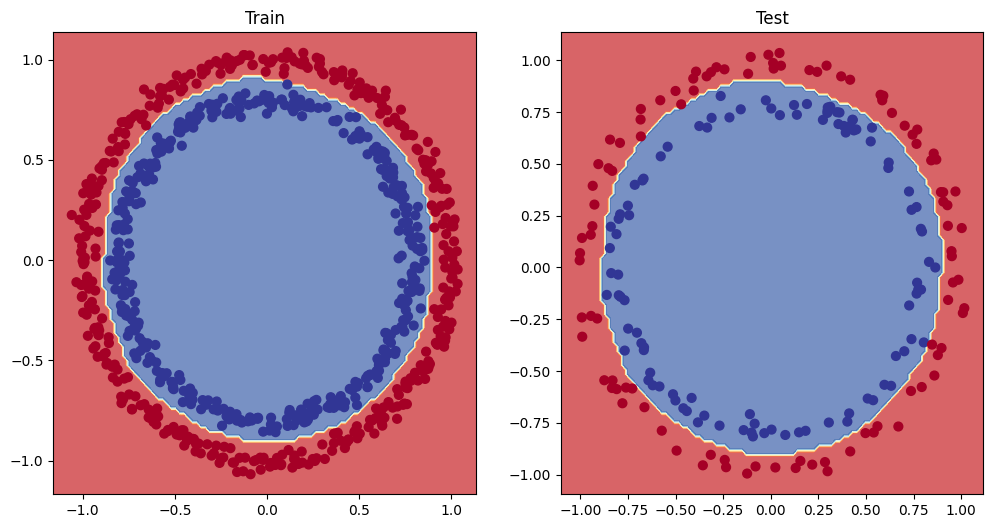

In [33]:
#Plot decision boundery of the model
plt.figure(figsize=(12,6))
plt.subplot(1, 2, 1)
plt.title("Train")
plot_decision_boundary(model_0, X_train, y_train)
plt.subplot(1,2,2)
plt.title("Test")
plot_decision_boundary(model_0, X_test, y_test)

##5. Improving a model (from a model perspective)

* Add more layers - give the model more chances to learn about patterns in the data
* Add more hidden units - go from 5 hidden units to 10hidden units
* Fit for longer
* Changing the activation funtion
* Changinng the learning rate
* Change the loss

And because these options are all values we (as machine learning engineers and data scientists) can change,  they are referred as **hyperparameters**

Let's try and improve our model by:
* Adding more hidden units: 5->10
* Increase the number of layers: 2->3
* Increase the number of epochs: 100->1000



In [34]:
class CircleModelV1(nn.Module):
  def __init__(self):
    super().__init__()
    self.layer_1 = nn.Linear(in_features=2, out_features=10)
    self.layer_2 = nn.Linear(in_features=10,out_features=10)
    self.layer_3 = nn.Linear(in_features=10, out_features=1)

  def forward(self,x):
    # z=self.layer_1(x)
    # z=self.layer_2(z)
    # z=self.layer_3(z)
    return self.layer_3(self.layer_2(self.layer_1(x))) #this way of writing operations leverages speed ups where possible behindthe scenes
model_1 = CircleModelV1().to(device)
model_1

CircleModelV1(
  (layer_1): Linear(in_features=2, out_features=10, bias=True)
  (layer_2): Linear(in_features=10, out_features=10, bias=True)
  (layer_3): Linear(in_features=10, out_features=1, bias=True)
)

In [35]:
#Create a loss function
loss_fn = nn.BCEWithLogitsLoss()

#Createan optimizer
optimizer = torch.optim.SGD(params=model_1.parameters(),
                            lr=0.1)

In [36]:
#Write a training and evaluation loop for model_1
torch.manual_seed(42)
torch.cuda.manual_seed(42)

#Train for longer
epochs=1000

#Put data to target device
X_train, y_train = X_train.to(device), y_train.to(device)
X_test, y_test = X_test.to(device), y_test.to(device)

for epoch in range(epochs):
  ###Training
  model_1.train()

  #1. Forward pass
  y_logits = model_1(X_train).squeeze()
  y_pred = torch.round(torch.sigmoid(y_logits)) #logits -> pred probabilities ->pred labels

  #2. Calculate the loss/acc
  loss=loss_fn(y_logits, y_train)
  accuracy = accuracy_fn(y_true=y_train,
                         y_pred=y_pred)

  #3. Optimizer zero grad
  optimizer.zero_grad()

  #4. Loss backwards (backpropagation)
  loss.backward()

  #5. Optimizer step (gradient descent)
  optimizer.step()

  ###Testing
  model_1.eval()
  with torch.inference_mode():
    #1. Forward pass
    test_logits = model_1(X_test).squeeze()
    test_pred = torch.round(torch.sigmoid(test_logits))
    #2 Calculate loss
    test_loss =loss_fn(test_logits,
                       y_test)
    test_acc = accuracy_fn(y_true=y_test,
                           y_pred = test_pred)
  if epoch % 100 == 0:
    print(f"Epoch: {epoch} | Loss {loss:.5f}, Acc: {acc:.2f}% | Test loss: {test_loss:.5f}, Test accuracy:{test_acc:.2f}%")



Epoch: 0 | Loss 0.69396, Acc: 99.88% | Test loss: 0.69261, Test accuracy:51.00%
Epoch: 100 | Loss 0.69305, Acc: 99.88% | Test loss: 0.69379, Test accuracy:48.00%
Epoch: 200 | Loss 0.69299, Acc: 99.88% | Test loss: 0.69437, Test accuracy:46.00%
Epoch: 300 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69458, Test accuracy:45.00%
Epoch: 400 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69465, Test accuracy:46.00%
Epoch: 500 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69467, Test accuracy:46.00%
Epoch: 600 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69468, Test accuracy:46.00%
Epoch: 700 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69468, Test accuracy:46.00%
Epoch: 800 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69468, Test accuracy:46.00%
Epoch: 900 | Loss 0.69298, Acc: 99.88% | Test loss: 0.69468, Test accuracy:46.00%


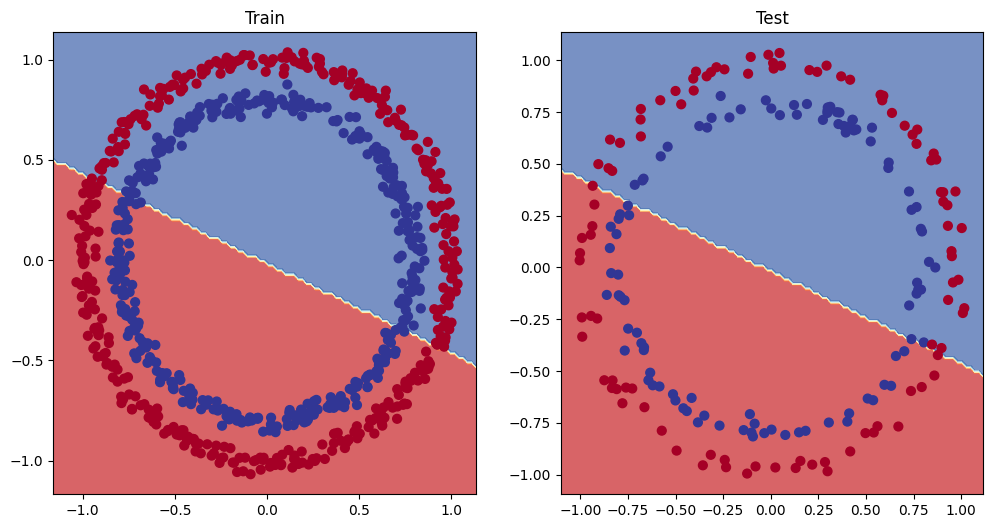

In [37]:
#Plot the decision boundary
#Plot decision boundery of the model
plt.figure(figsize=(12,6))
plt.subplot(1, 2, 1)
plt.title("Train")
plot_decision_boundary(model_1, X_train, y_train)
plt.subplot(1,2,2)
plt.title("Test")
plot_decision_boundary(model_1, X_test, y_test)

###Trying to evaluate this model on previos dataset - it's impossible

###5.1.Preparing data to see if our model can fit a straight line

One way to troubleshoot a big problem is to test out a smaller problem.


In [38]:
weight=0.7
bias=0.3
start=0
end=1
step=0.01

#Create data
X_regression = torch.arange(start,end,step).unsqueeze(dim=1)
y_regression = weight*X_regression+bias

print(len(X_regression))
X_regression[:5],y_regression[:5]

100


(tensor([[0.0000],
         [0.0100],
         [0.0200],
         [0.0300],
         [0.0400]]),
 tensor([[0.3000],
         [0.3070],
         [0.3140],
         [0.3210],
         [0.3280]]))

In [39]:
#Create train and test splits
train_split=int(0.8*len(X_regression))
X_train_regression, y_train_regression = X_regression[:train_split], y_regression[:train_split]
X_test_regression, y_test_regression = X_regression[train_split:], y_regression[train_split:]

#Check the length of each
len(X_train_regression), len(X_test_regression), len(y_train_regression), len(y_test_regression)

(80, 20, 80, 20)

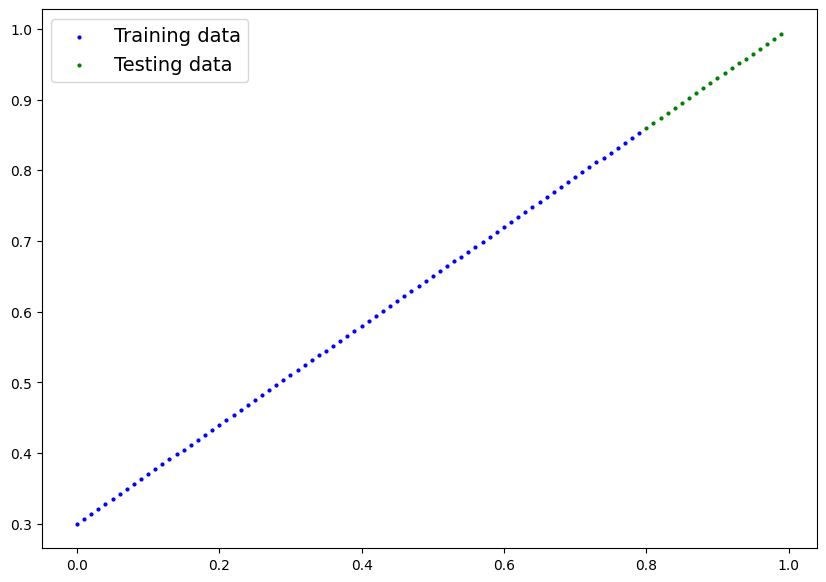

In [40]:
plot_predictions(train_data=X_train_regression,
                 train_labels=y_train_regression,
                 test_data=X_test_regression,
                 test_labels=y_test_regression)

In [41]:
model_1

CircleModelV1(
  (layer_1): Linear(in_features=2, out_features=10, bias=True)
  (layer_2): Linear(in_features=10, out_features=10, bias=True)
  (layer_3): Linear(in_features=10, out_features=1, bias=True)
)

### 5.2. Adjusting `model_1` to fit a straight line

In [42]:
#Same architecture as model_1 (but using nn.Sequential())
model_2 =nn.Sequential(
    nn.Linear(in_features=1, out_features=10),
    nn.Linear(in_features=10, out_features=10),
    nn.Linear(in_features=10, out_features=1)
).to(device)
model_2

Sequential(
  (0): Linear(in_features=1, out_features=10, bias=True)
  (1): Linear(in_features=10, out_features=10, bias=True)
  (2): Linear(in_features=10, out_features=1, bias=True)
)

In [43]:
#Loss and optimizer
loss_fn = nn.L1Loss()
optimizer=torch.optim.SGD(params=model_2.parameters(),
                          lr=0.001)

In [44]:
# Train the model
torch.manual_seed(42)
torch.cuda.manual_seed(42)

#Set the number of epochs
epochs=1000

#Put the data on the target device
X_train_regression,y_train_regression=X_train_regression.to(device),y_train_regression.to(device)
X_test_regression,y_test_regression=X_test_regression.to(device),y_test_regression.to(device)

#Training
for epoch in range(epochs):
  y_pred = model_2(X_train_regression)
  loss = loss_fn(y_pred, y_train_regression)
  optimizer.zero_grad()
  loss.backward()
  optimizer.step()

  # Testing
  model_2.eval()
  with torch.inference_mode():
    test_pred = model_2(X_test_regression)
    test_loss = loss_fn(test_pred, y_test_regression)

  #Print out what's happening
  if epoch % 100 == 0:
    print(f"Epoch: {epoch} | Loss {loss:.5f} | Test loss: {test_loss:.5f}")

Epoch: 0 | Loss 0.75986 | Test loss: 0.94965
Epoch: 100 | Loss 0.40272 | Test loss: 0.54029
Epoch: 200 | Loss 0.05876 | Test loss: 0.13480
Epoch: 300 | Loss 0.01461 | Test loss: 0.03342
Epoch: 400 | Loss 0.00308 | Test loss: 0.00008
Epoch: 500 | Loss 0.00309 | Test loss: 0.00012
Epoch: 600 | Loss 0.00309 | Test loss: 0.00018
Epoch: 700 | Loss 0.00299 | Test loss: 0.00011
Epoch: 800 | Loss 0.00299 | Test loss: 0.00016
Epoch: 900 | Loss 0.00289 | Test loss: 0.00011


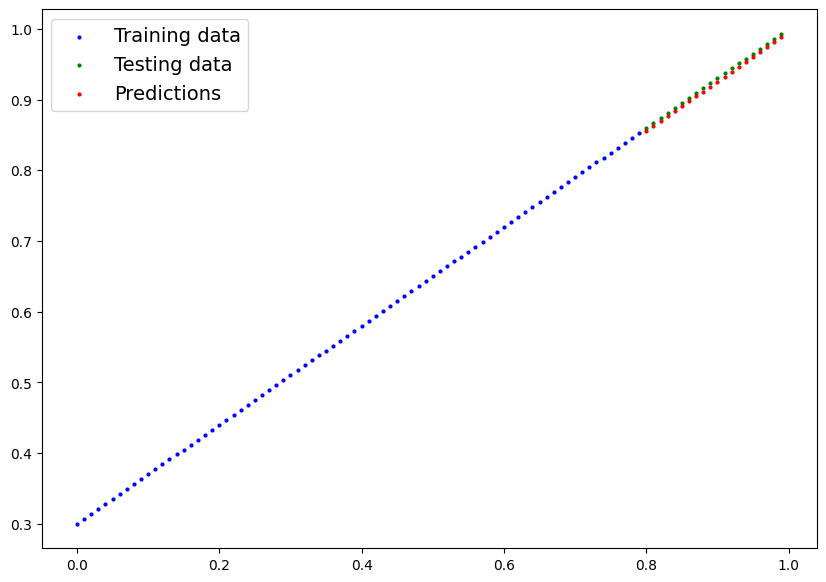

In [45]:
#Turn on evaluation mode
model_2.eval()

#Make predictions (inference)
with torch.inference_mode():
  y_preds = model_2(X_test_regression)

  #Plot data and predictions
plot_predictions(train_data=X_train_regression.cpu(),
                 train_labels=y_train_regression.cpu(),
                 test_data=X_test_regression.cpu(),
                 test_labels=y_test_regression.cpu(),
                 predictions=y_preds.cpu())

## 6. The missing piece: non-linearity

"What patterns could you draw if you were given an infinite amountof a straight and non-straight lines?"

Or in machine learning terms, an infinite (but really it is finite) of linear and non-linear patterns

### 6.1. Combining the power of linear and non-linear functions
Recreating non-linear data


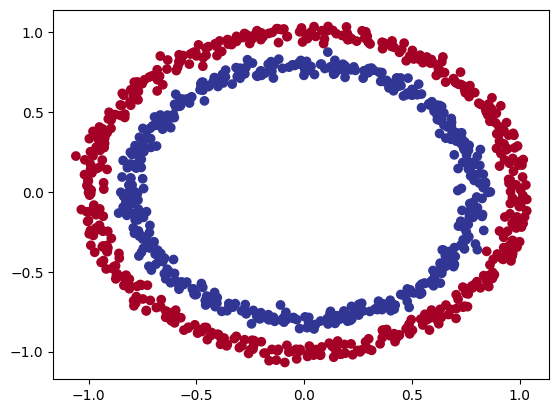

In [46]:
#Make and plot data
import matplotlib.pyplot as plt
from sklearn.datasets import make_circles

n_samples = 1000

X, y = make_circles(n_samples,
                    noise=0.03,
                    random_state=42)
plt.scatter(X[:,0],X[:,1], c=y, cmap=plt.cm.RdYlBu)

In [47]:
#Convert data to tensors and then to train and test split
import torch
from sklearn.model_selection import train_test_split

#Turn data into tensors
X = torch.from_numpy(X).type(torch.float)
y = torch.from_numpy(y).type(torch.float)

#Split into train and test sets

X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    test_size=0.2,
                                                    random_state=42)
X_train[:5], y_train[:5]

(tensor([[ 0.6579, -0.4651],
         [ 0.6319, -0.7347],
         [-1.0086, -0.1240],
         [-0.9666, -0.2256],
         [-0.1666,  0.7994]]),
 tensor([1., 0., 0., 0., 1.]))

### 6.2. Building a model with non-linearity

* Linear = straight lines
* Non-linear - non straight lines

Artificial neural networks are a large combination of linear (straight) and non-straight(non-linear) functions which are potentially able to find patterns in data.

In [48]:
# Build a model with non-linear ativation functions
from torch import nn
class CircleModelV2(nn.Module):
  def __init__(self):
    super().__init__()
    self.layer_1 = nn.Linear(in_features=2,out_features=10)
    self.layer_2 = nn.Linear(in_features=10, out_features=10)
    self.layer_3 = nn.Linear(in_features=10, out_features=1)
    self.relu = nn.ReLU() # relu is a non-linear activation function

  def forward(self, x):
    #Where should we put our non-linear activation functions?
    return self.layer_3(self.relu(self.layer_2(self.relu(self.layer_1(x)))))

model_3 = CircleModelV2().to(device)
model_3

CircleModelV2(
  (layer_1): Linear(in_features=2, out_features=10, bias=True)
  (layer_2): Linear(in_features=10, out_features=10, bias=True)
  (layer_3): Linear(in_features=10, out_features=1, bias=True)
  (relu): ReLU()
)

In [49]:
#Create a loss function
loss_fn = nn.BCEWithLogitsLoss()

#Createan optimizer
optimizer = torch.optim.SGD(params=model_3.parameters(),
                            lr=0.01)


In [50]:
next(model_3.parameters()).device

device(type='cuda', index=0)

In [51]:
#Random seeds
epochs = 10000
X_train, y_train = X_train.to(device), y_train.to(device)
X_test, y_test = X_test.to(device), y_test.to(device)

In [52]:
X_train.device

device(type='cuda', index=0)

Epoch: 0 | Train loss: 0.6929, Train_accuracy: 50.00% | Test loss: 0.6932, Test accuracy: 50.00%
Epoch: 100 | Train loss: 0.6925, Train_accuracy: 50.38% | Test loss: 0.6926, Test accuracy: 50.00%
Epoch: 200 | Train loss: 0.6922, Train_accuracy: 59.00% | Test loss: 0.6923, Test accuracy: 56.00%
Epoch: 300 | Train loss: 0.6921, Train_accuracy: 70.12% | Test loss: 0.6921, Test accuracy: 67.00%
Epoch: 400 | Train loss: 0.6919, Train_accuracy: 68.38% | Test loss: 0.6920, Test accuracy: 70.00%
Epoch: 500 | Train loss: 0.6918, Train_accuracy: 58.50% | Test loss: 0.6918, Test accuracy: 62.00%
Epoch: 600 | Train loss: 0.6917, Train_accuracy: 54.00% | Test loss: 0.6916, Test accuracy: 56.00%
Epoch: 700 | Train loss: 0.6915, Train_accuracy: 53.25% | Test loss: 0.6915, Test accuracy: 53.00%
Epoch: 800 | Train loss: 0.6914, Train_accuracy: 52.62% | Test loss: 0.6913, Test accuracy: 53.00%
Epoch: 900 | Train loss: 0.6913, Train_accuracy: 52.75% | Test loss: 0.6912, Test accuracy: 53.00%
Epoch: 1000 

<ipython-input-53-fda9cb22b296>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,6))


Epoch: 2100 | Train loss: 0.6896, Train_accuracy: 53.87% | Test loss: 0.6892, Test accuracy: 55.00%
Epoch: 2200 | Train loss: 0.6895, Train_accuracy: 55.12% | Test loss: 0.6890, Test accuracy: 56.00%
Epoch: 2300 | Train loss: 0.6893, Train_accuracy: 54.87% | Test loss: 0.6888, Test accuracy: 56.00%
Epoch: 2400 | Train loss: 0.6891, Train_accuracy: 53.75% | Test loss: 0.6886, Test accuracy: 56.00%
Epoch: 2500 | Train loss: 0.6889, Train_accuracy: 53.50% | Test loss: 0.6884, Test accuracy: 56.00%
Epoch: 2600 | Train loss: 0.6887, Train_accuracy: 53.50% | Test loss: 0.6882, Test accuracy: 56.00%
Epoch: 2700 | Train loss: 0.6886, Train_accuracy: 53.25% | Test loss: 0.6880, Test accuracy: 56.00%
Epoch: 2800 | Train loss: 0.6884, Train_accuracy: 53.25% | Test loss: 0.6877, Test accuracy: 56.00%
Epoch: 2900 | Train loss: 0.6882, Train_accuracy: 53.00% | Test loss: 0.6875, Test accuracy: 56.00%
Epoch: 3000 | Train loss: 0.6879, Train_accuracy: 53.00% | Test loss: 0.6872, Test accuracy: 56.00%


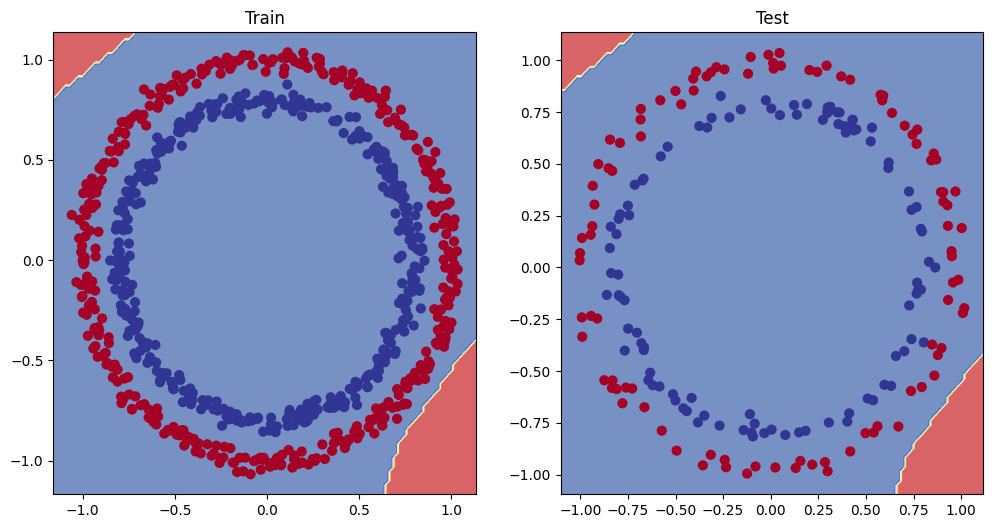

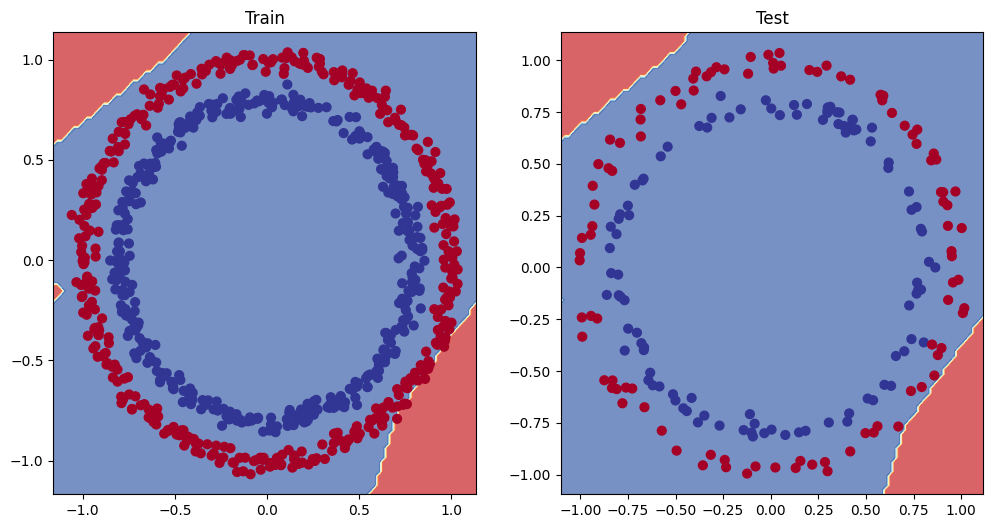

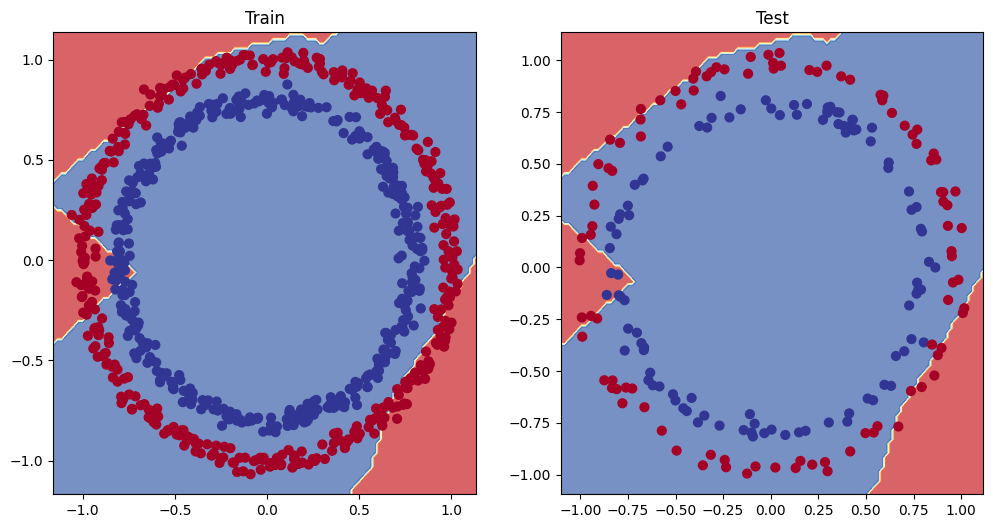

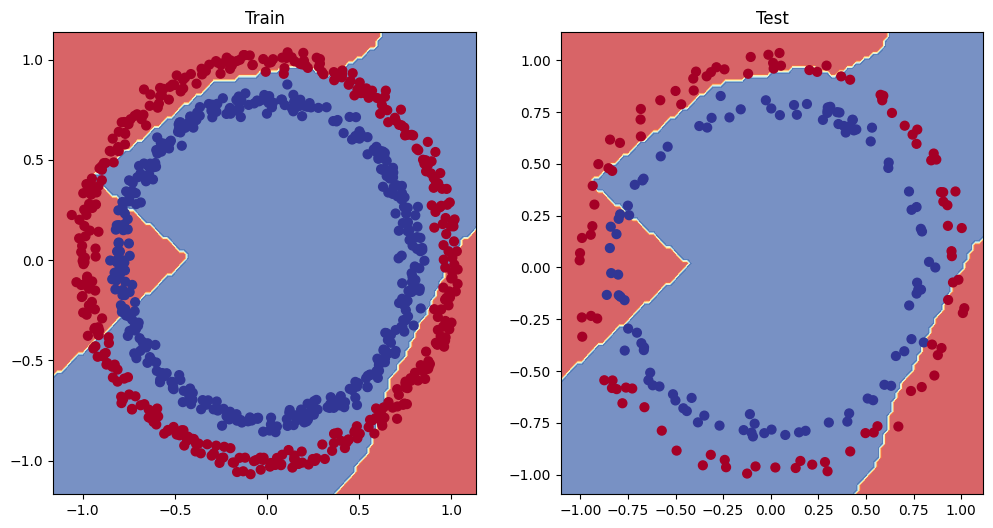

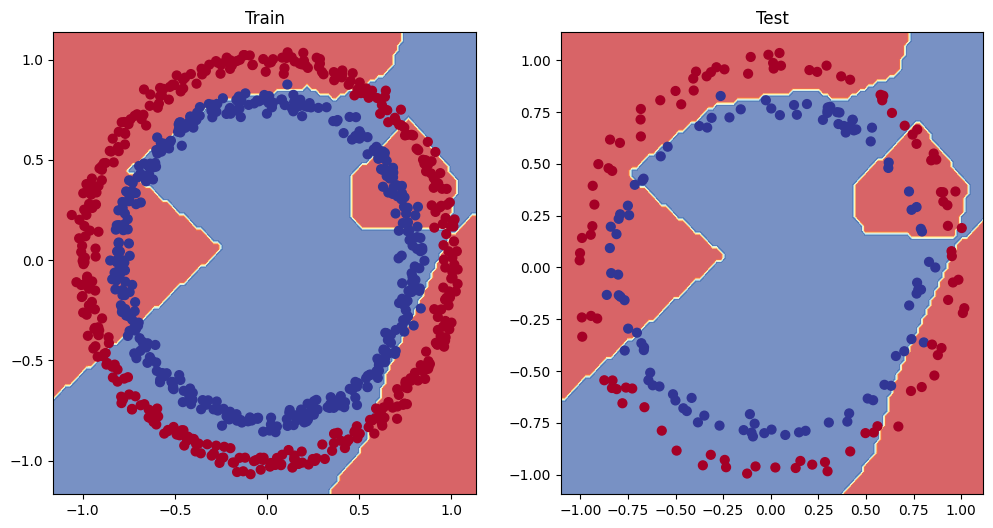

...

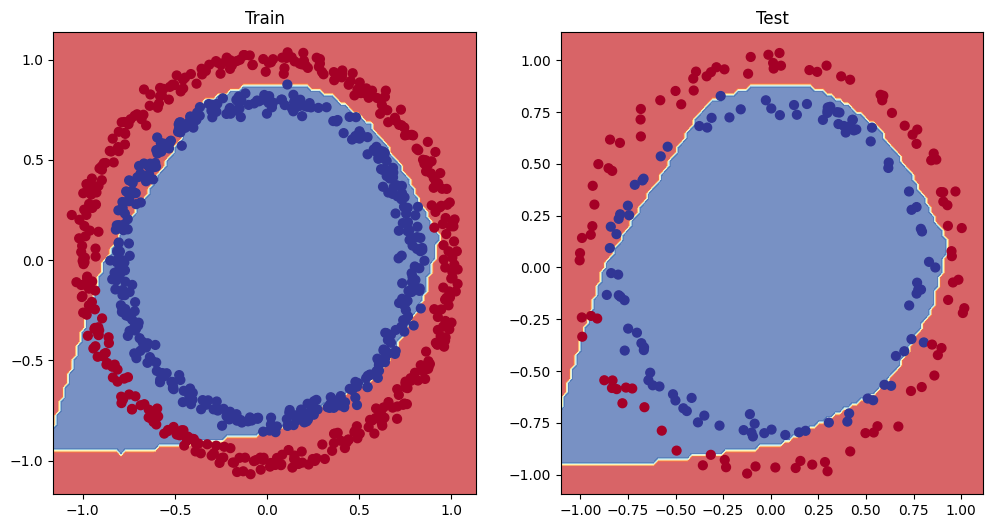

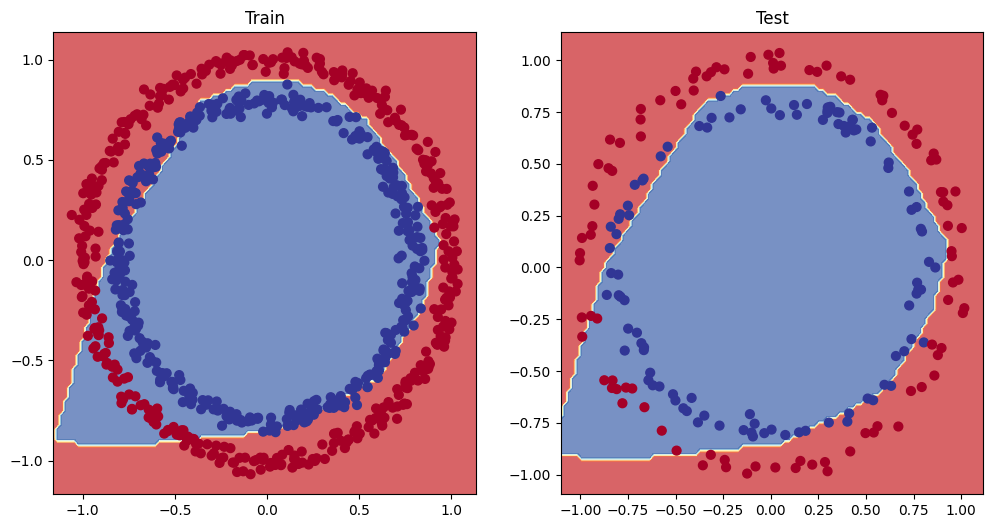

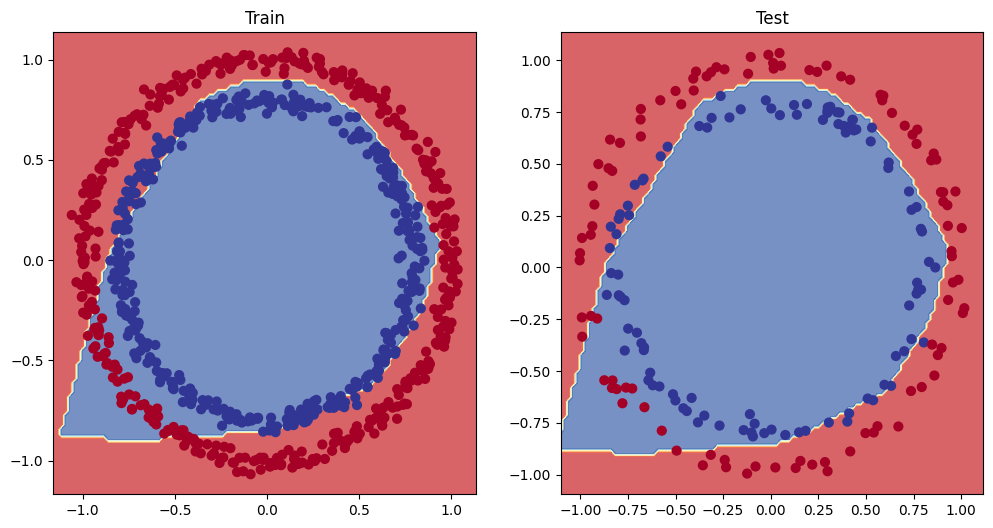

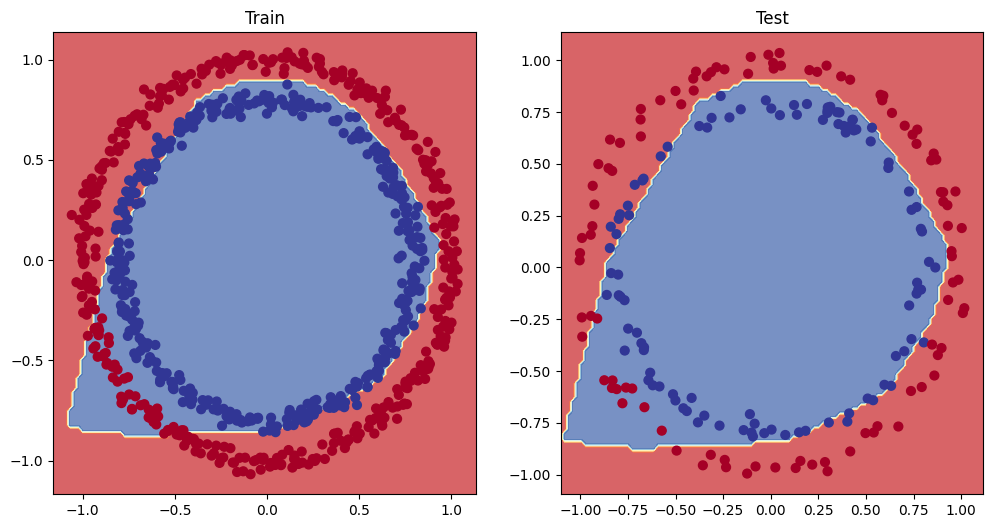

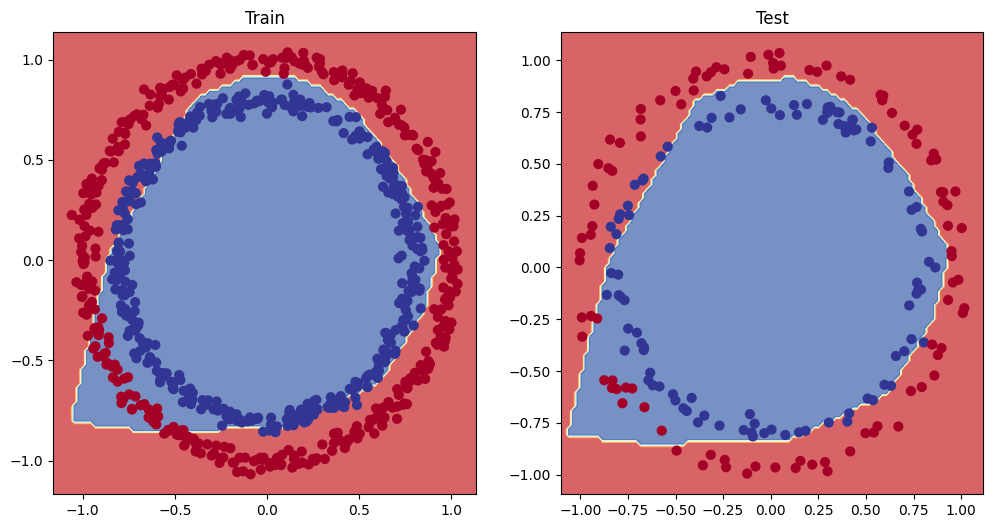

In [53]:
for epoch in range(epochs):
  ##Training
  model_3.train()
  #Forward_pass
  y_logits = (model_3.to(device))(X_train).squeeze()
  y_pred = torch.round(torch.sigmoid(y_logits))#logits->prediction probabilities->prediction label
  #Calculate loss
  loss = loss_fn(y_logits, y_train)
  accuracy=accuracy_fn(y_true=y_train,
                       y_pred=y_pred)
  #Optimizer zero grad
  optimizer.zero_grad()
  #Loss backward
  loss.backward()
  #Step the optimizer
  optimizer.step()

  ###Testing
  model_3.eval()
  with torch.inference_mode():
    test_logits = model_3(X_test).squeeze()
    pred_test = torch.round(torch.sigmoid(test_logits))
  test_loss = loss_fn(test_logits, y_test)
  test_accuracy = accuracy_fn(y_true=y_test,
                                y_pred=pred_test)
  #Print out what's happening
  if epoch % 100 == 0:
    print(f"Epoch: {epoch} | Train loss: {loss:.4f}, Train_accuracy: {accuracy:.2f}% | Test loss: {test_loss:.4f}, Test accuracy: {test_accuracy:.2f}%")
    plt.figure(figsize=(12,6))
    plt.subplot(1, 2, 1)
    plt.title("Train")
    plot_decision_boundary(model_3, X_train, y_train)
    plt.subplot(1,2,2)
    plt.title("Test")
    plot_decision_boundary(model_3, X_test, y_test)


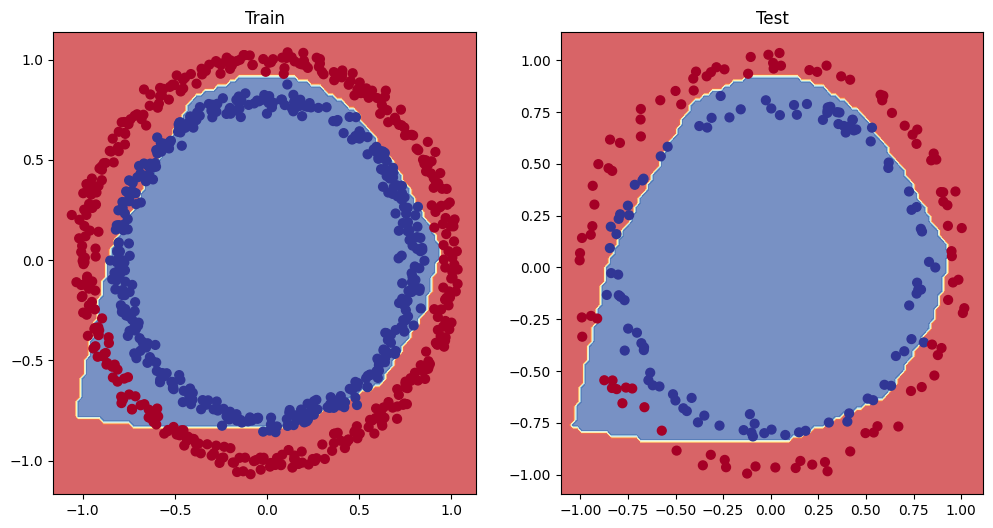

In [54]:
#Plot the decision boundary
#Plot decision boundery of the model
plt.figure(figsize=(12,6))
plt.subplot(1, 2, 1)
plt.title("Train")
plot_decision_boundary(model_3, X_train, y_train)
plt.subplot(1,2,2)
plt.title("Test")
plot_decision_boundary(model_3, X_test, y_test)

In [55]:
model_3.eval()
with torch.inference_mode():
  y_preds=torch.round(torch.sigmoid(model_3.to(device)(X_test))).squeeze()
y_preds[:10], y_test[:10]

(tensor([1., 0., 1., 0., 0., 1., 0., 0., 1., 0.], device='cuda:0'),
 tensor([1., 0., 1., 0., 1., 1., 0., 0., 1., 0.], device='cuda:0'))

## 7. Replicating non-linear activation functions

Neural networks, rather than us telling the model what to learn, we give it the tools to discover patterns in date and it tries to figure out the patterns on its own.

And these tools are linear and non-linear functions.

In [56]:
#Create a tensor
A = torch.arange(-10, 10, 1, dtype=torch.float32)
A.dtype

torch.float32

In [57]:
A

tensor([-10.,  -9.,  -8.,  -7.,  -6.,  -5.,  -4.,  -3.,  -2.,  -1.,   0.,   1.,
          2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.])

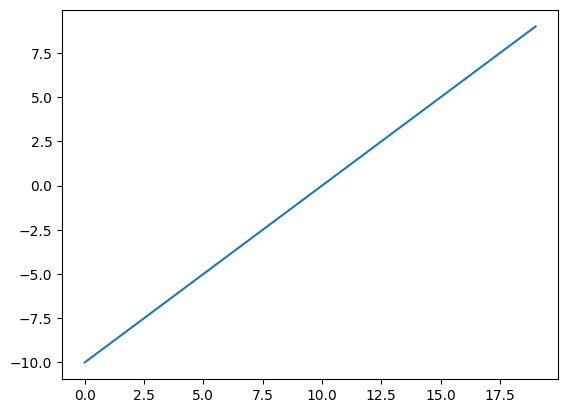

In [58]:
#Visualize the tensor
plt.plot(A)

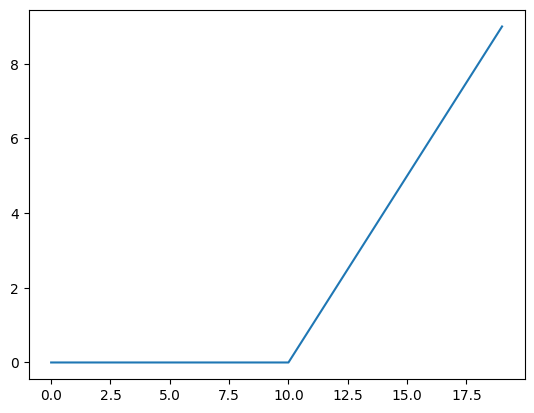

In [59]:
plt.plot(torch.relu(A))

In [60]:
def relu(x):
  return torch.maximum(torch.tensor(0), x) #inputs must be tensors

relu(A)

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 2., 3., 4., 5., 6., 7.,
        8., 9.])

Relu activation function turns all negative numbers into zero, because it takes a maximum between zero and input

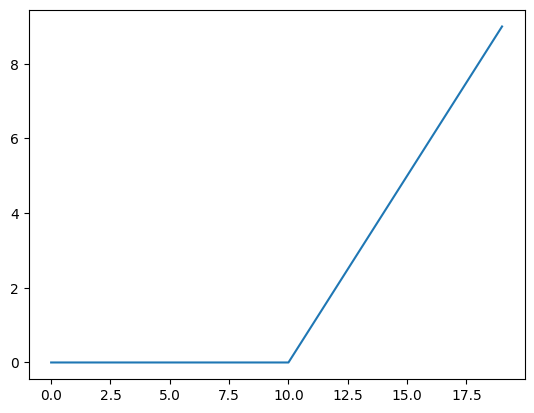

In [61]:
#Plot ReLU activation function
plt.plot(relu(A))

In [62]:
#Now let's do the same for Sigmoid
def sigmoid(x):
  return 1 / (1 + torch.exp(-x))

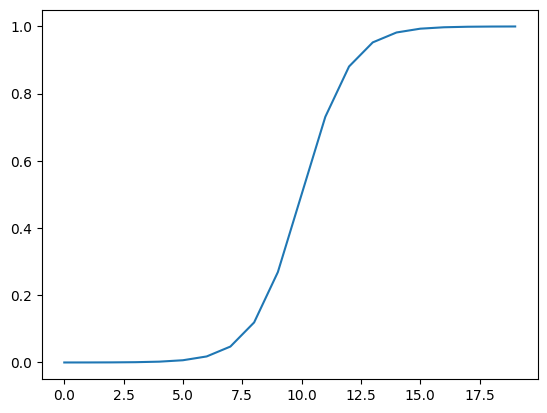

In [63]:
plt.plot(sigmoid(A))

## 8. Putting it all together with a multi-class classification problem

* Binary classification = one thing or another (cat vs. dog, spam vs. not spam, fraud or not fraud)
* Multi-class classification = more then one thing or another

### 8.1 Creating a toy multiclass dataset

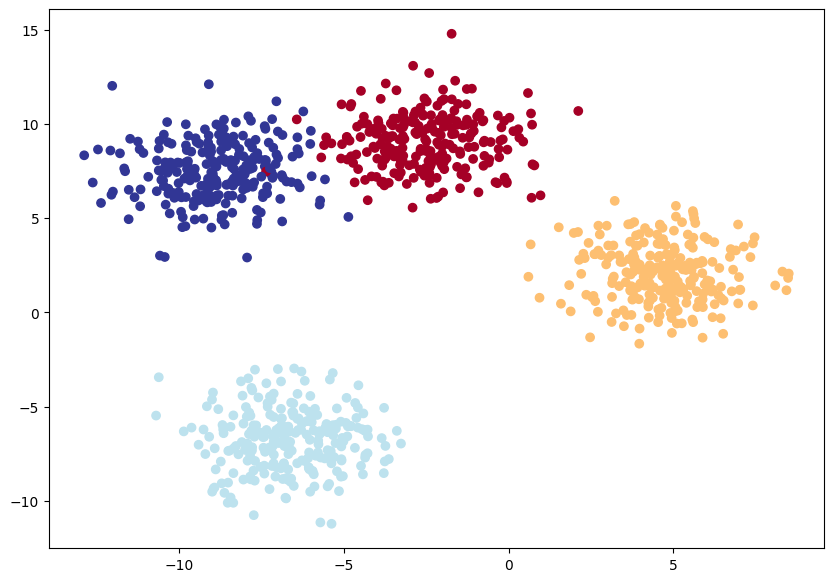

In [90]:
import torch
from torch import nn
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.model_selection import train_test_split

#Set the hyperparameters for data creation
NUM_CLASSES = 4
NUM_FEATURES = 2
RANDOM_SEED = 42

#1. Create multi-class data

X_blob, y_blob = make_blobs(n_samples=1000,
                            n_features=NUM_FEATURES,
                            centers=NUM_CLASSES,
                            cluster_std=1.5, #give the clasters a little shake up
                            random_state=RANDOM_SEED)

# 2. Turn data into tensors
X_blob = torch.from_numpy(X_blob).type(torch.float)
y_blob = torch.from_numpy(y_blob).type(torch.LongTensor)

#3. Split into train and test
X_blob_train, X_blob_test, y_blob_train, y_blob_test = train_test_split(X_blob,
                                                                        y_blob,
                                                                        test_size=0.2,
                                                                        random_state=RANDOM_SEED)

#Plot data (visualize, visualize, visualize)
plt.figure(figsize=(10,7))
plt.scatter(X_blob[:, 0], X_blob[:, 1], c=y_blob, cmap=plt.cm.RdYlBu )

##8.2. Building a multi-class classification model in PyTorch

In [122]:
#Create device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [123]:
#Build a multi-class classification model
class BlobModel(nn.Module):
  def __init__(self, input_features, output_features, hidden_units=8):
   """Initializes multi-class classification model.
    Args:
      input_features(int):Number of input features to the model
      output_features (int):Number of output features (number of output classes)
      hidden_units (int): Number of hidden units between layers, default 8

    Returns:

    Example:

    """
   super().__init__()
   self.linear_layer_stack = nn.Sequential(
       nn.Linear(in_features=input_features, out_features=hidden_units),
       nn.ReLU(),
       nn.Linear(in_features=hidden_units, out_features=hidden_units),
       nn.ReLU(),
       nn.Linear(in_features=hidden_units, out_features=output_features)
   )
  def forward(self, x):
    return self.linear_layer_stack(x)

#Create an instance of BlobModel and send it to the target device
model_4=BlobModel(input_features=2,
                  output_features=4,
                  hidden_units=8).to(device)


In [124]:
X_blob_train.shape,y_blob_train.shape

(torch.Size([800, 2]), torch.Size([800]))

In [125]:
torch.unique(y_blob_train)

tensor([0, 1, 2, 3], device='cuda:0')

In [126]:
model_4

BlobModel(
  (linear_layer_stack): Sequential(
    (0): Linear(in_features=2, out_features=8, bias=True)
    (1): ReLU()
    (2): Linear(in_features=8, out_features=8, bias=True)
    (3): ReLU()
    (4): Linear(in_features=8, out_features=4, bias=True)
  )
)

### 8.3. Create a loss function and an optimizer for a multi-class classification model

In [127]:
#Create a loss function for multi-classclassification
loss_fn = nn.CrossEntropyLoss()

#Create an optimizer for multi-class classification
optimizer = torch.optim.SGD(params=model_4.parameters(),
                            lr=0.1) #learning rate is a hyperparameter

### 8.4 Getting prediction probabilities for a multi-lass PyTorch model

Raw logits(raw output of the model)->Pred probs(use `torch.softmax`)->Pred labels(take the argmax of the predictionprobabilities)

In [128]:
#Let's get raw data from our model
model_4(X_blob_test.to(device))

tensor([[-7.6459e-01, -7.4120e-01, -1.5777e+00, -1.1376e+00],
        [-9.7256e-02, -9.4310e-01, -5.9631e-01, -1.3715e-01],
        [ 2.5277e-01, -2.3794e-01,  1.8817e-01, -6.5686e-03],
        [-4.1340e-01, -5.2042e-01, -9.3033e-01, -6.9626e-01],
        [-3.1184e-01, -1.3736e+00, -1.1991e+00, -3.8337e-01],
        [-1.4971e-01, -1.0617e+00, -7.1069e-01, -1.6452e-01],
        [ 1.5388e-01, -2.8874e-01,  1.5199e-01, -1.0874e-02],
        [-2.1543e-01, -1.1795e+00, -9.3000e-01, -2.7448e-01],
        [ 2.4432e-01, -2.4716e-01,  1.6492e-01,  6.1044e-03],
        [-2.3286e-01, -1.2120e+00, -9.8487e-01, -3.0037e-01],
        [-1.7742e-01, -1.1008e+00, -8.2929e-01, -2.3689e-01],
        [-9.4082e-01, -7.8985e-01, -1.8480e+00, -1.3347e+00],
        [-2.9723e-01, -1.3458e+00, -1.1543e+00, -3.6287e-01],
        [-2.9006e-01, -1.3393e+00, -1.1146e+00, -3.3518e-01],
        [-3.3713e-01, -1.4374e+00, -1.2379e+00, -3.8029e-01],
        [-1.0260e-01, -9.5066e-01, -6.1913e-01, -1.5105e-01],
        

In [129]:
model_4.eval()
with torch.inference_mode():
  y_logits = model_4(X_blob_test.to(device))
y_logits[:10]

tensor([[-0.7646, -0.7412, -1.5777, -1.1376],
        [-0.0973, -0.9431, -0.5963, -0.1371],
        [ 0.2528, -0.2379,  0.1882, -0.0066],
        [-0.4134, -0.5204, -0.9303, -0.6963],
        [-0.3118, -1.3736, -1.1991, -0.3834],
        [-0.1497, -1.0617, -0.7107, -0.1645],
        [ 0.1539, -0.2887,  0.1520, -0.0109],
        [-0.2154, -1.1795, -0.9300, -0.2745],
        [ 0.2443, -0.2472,  0.1649,  0.0061],
        [-0.2329, -1.2120, -0.9849, -0.3004]], device='cuda:0')

In [130]:
#Convert our model's logit outputs to prediction probabilities
y_pred_probs = torch.softmax(y_logits, dim=1)
print(y_logits[:5])
print(y_pred_probs[:5])

tensor([[-0.7646, -0.7412, -1.5777, -1.1376],
        [-0.0973, -0.9431, -0.5963, -0.1371],
        [ 0.2528, -0.2379,  0.1882, -0.0066],
        [-0.4134, -0.5204, -0.9303, -0.6963],
        [-0.3118, -1.3736, -1.1991, -0.3834]], device='cuda:0')
tensor([[0.3169, 0.3244, 0.1405, 0.2182],
        [0.3336, 0.1432, 0.2026, 0.3206],
        [0.3011, 0.1843, 0.2823, 0.2323],
        [0.3078, 0.2766, 0.1836, 0.2320],
        [0.3719, 0.1286, 0.1532, 0.3463]], device='cuda:0')


In [131]:
torch.sum(y_pred_probs[0])

tensor(1., device='cuda:0')

In [132]:
torch.argmax(y_pred_probs[0])

tensor(1, device='cuda:0')

In [133]:
#Convert our model prediction probs to prediction values
y_preds = torch.argmax(y_pred_probs, dim=1)
y_preds


tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 1, 0, 1, 0, 0, 0,
        0, 0, 0, 0, 3, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')

In [134]:
y_blob_test

tensor([1, 3, 2, 1, 0, 3, 2, 0, 2, 0, 0, 1, 0, 0, 0, 3, 3, 2, 3, 3, 3, 0, 1, 2,
        2, 2, 3, 0, 1, 0, 3, 1, 1, 3, 1, 2, 1, 3, 0, 2, 0, 3, 3, 2, 0, 3, 1, 1,
        0, 3, 1, 0, 1, 1, 3, 2, 1, 1, 3, 2, 2, 0, 3, 2, 2, 0, 0, 3, 3, 0, 0, 3,
        3, 3, 2, 3, 3, 3, 3, 1, 0, 2, 3, 2, 3, 3, 2, 3, 3, 2, 3, 3, 1, 3, 3, 3,
        1, 0, 3, 2, 0, 0, 3, 0, 2, 3, 1, 0, 3, 2, 1, 1, 0, 2, 2, 3, 0, 0, 1, 2,
        2, 3, 0, 1, 2, 0, 0, 0, 2, 3, 1, 2, 3, 2, 0, 3, 0, 0, 1, 1, 1, 0, 2, 2,
        2, 2, 0, 3, 3, 2, 2, 1, 3, 2, 0, 0, 3, 3, 2, 1, 2, 0, 3, 2, 0, 3, 2, 0,
        2, 2, 2, 0, 3, 1, 1, 1, 1, 1, 3, 1, 0, 2, 2, 1, 2, 2, 0, 1, 2, 2, 0, 0,
        1, 3, 2, 0, 3, 1, 2, 1], device='cuda:0')

### 8.5 Create a trainig loop and testing loop for a multi-class PyTorch model

In [135]:
#Fit the multi-class model to the data
torch.manual_seed(42)
torch.cuda.manual_seed(42)

#Set number of epochs
epochs = 100

#Put data to the target device
X_blob_train, y_blob_train = X_blob_train.to(device), y_blob_train.to(device)
X_blob_test, y_blob_test = X_blob_test.to(device), y_blob_test.to(device)

Epoch: 0 | Loss: 1.1588, Accuracy:40.38% | Test loss:1.0755, Accuraccy:48.00%
Epoch: 1 | Loss: 1.0636, Accuracy:54.62% | Test loss:1.0039, Accuraccy:55.00%
Epoch: 2 | Loss: 0.9801, Accuracy:61.38% | Test loss:0.9413, Accuraccy:64.00%
Epoch: 3 | Loss: 0.9094, Accuracy:67.62% | Test loss:0.8877, Accuraccy:74.50%
Epoch: 4 | Loss: 0.8508, Accuracy:76.75% | Test loss:0.8419, Accuraccy:90.50%
Epoch: 5 | Loss: 0.8023, Accuracy:91.12% | Test loss:0.8027, Accuraccy:94.00%
Epoch: 6 | Loss: 0.7617, Accuracy:93.38% | Test loss:0.7686, Accuraccy:95.00%
Epoch: 7 | Loss: 0.7271, Accuracy:94.50% | Test loss:0.7384, Accuraccy:95.00%
Epoch: 8 | Loss: 0.6970, Accuracy:95.38% | Test loss:0.7110, Accuraccy:96.00%
Epoch: 9 | Loss: 0.6699, Accuracy:96.38% | Test loss:0.6853, Accuraccy:97.00%
Epoch: 10 | Loss: 0.6448, Accuracy:96.75% | Test loss:0.6607, Accuraccy:97.50%
Epoch: 11 | Loss: 0.6210, Accuracy:97.25% | Test loss:0.6367, Accuraccy:98.00%
Epoch: 12 | Loss: 0.5979, Accuracy:97.75% | Test loss:0.6128, 

<ipython-input-136-dbee03a49302>:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,6))


Epoch: 23 | Loss: 0.3696, Accuracy:99.00% | Test loss:0.3717, Accuraccy:100.00%
Epoch: 24 | Loss: 0.3523, Accuracy:99.00% | Test loss:0.3533, Accuraccy:100.00%
Epoch: 25 | Loss: 0.3355, Accuracy:99.12% | Test loss:0.3352, Accuraccy:100.00%
Epoch: 26 | Loss: 0.3189, Accuracy:99.12% | Test loss:0.3173, Accuraccy:99.50%
Epoch: 27 | Loss: 0.3024, Accuracy:99.12% | Test loss:0.2994, Accuraccy:99.50%
Epoch: 28 | Loss: 0.2860, Accuracy:99.12% | Test loss:0.2814, Accuraccy:99.50%
Epoch: 29 | Loss: 0.2696, Accuracy:99.12% | Test loss:0.2633, Accuraccy:99.50%
Epoch: 30 | Loss: 0.2529, Accuracy:99.12% | Test loss:0.2451, Accuraccy:99.50%
Epoch: 31 | Loss: 0.2362, Accuracy:99.12% | Test loss:0.2268, Accuraccy:99.50%
Epoch: 32 | Loss: 0.2194, Accuracy:99.25% | Test loss:0.2088, Accuraccy:99.50%
Epoch: 33 | Loss: 0.2028, Accuracy:99.25% | Test loss:0.1913, Accuraccy:99.50%
Epoch: 34 | Loss: 0.1866, Accuracy:99.25% | Test loss:0.1746, Accuraccy:99.50%
Epoch: 35 | Loss: 0.1712, Accuracy:99.25% | Test 

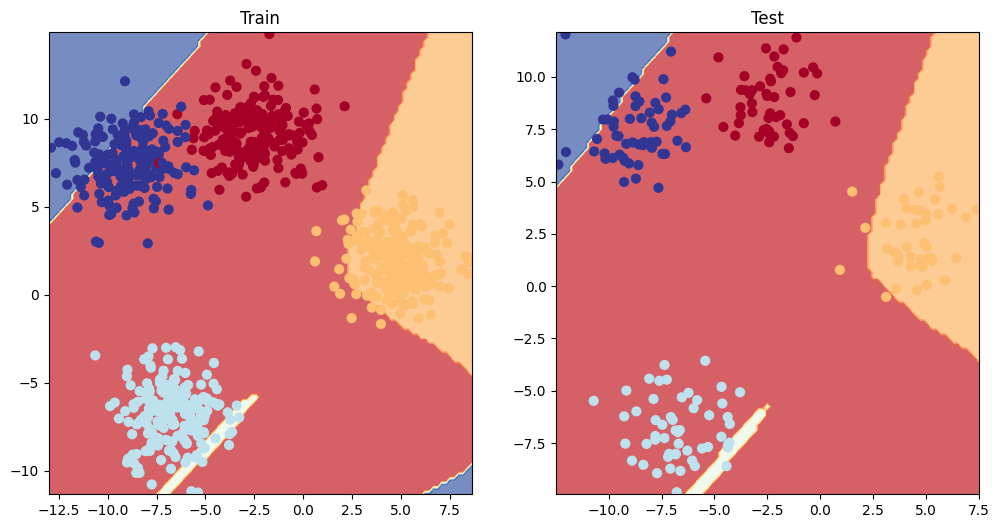

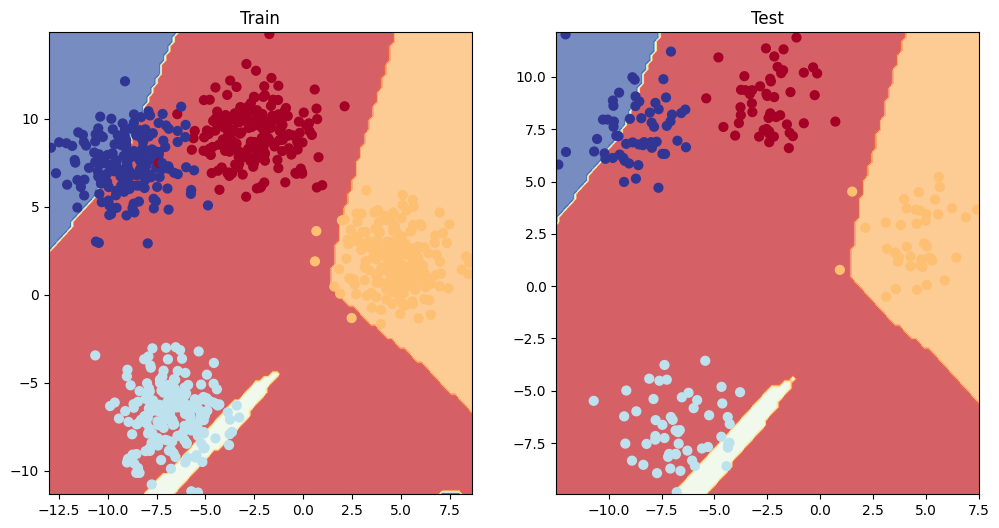

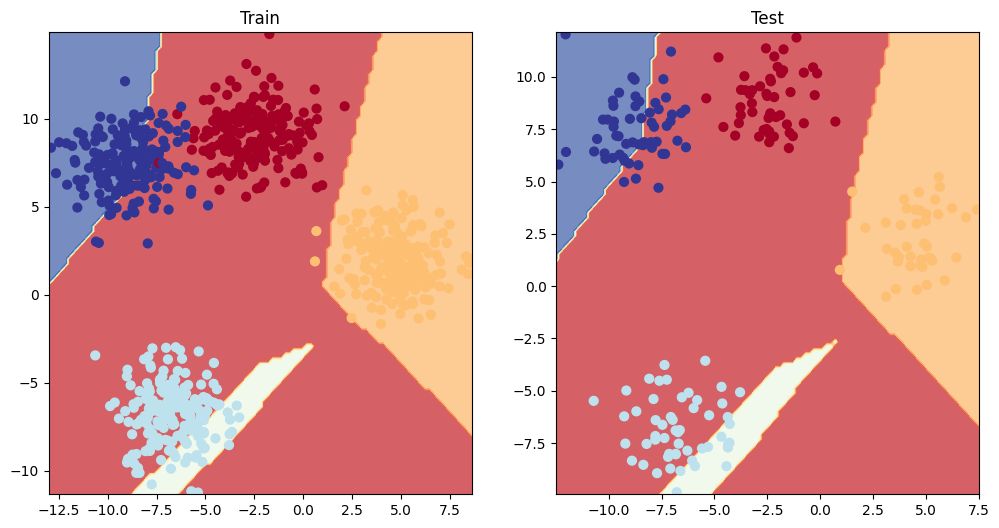

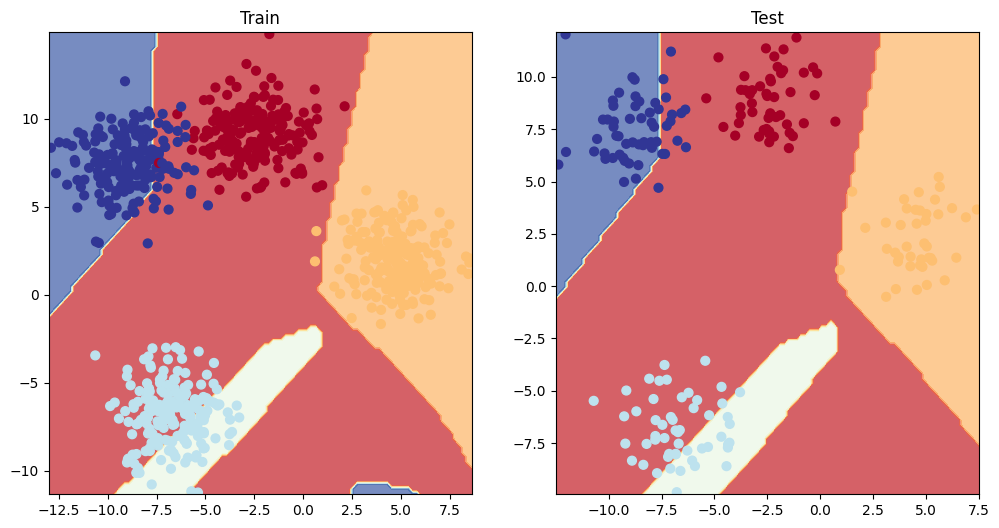

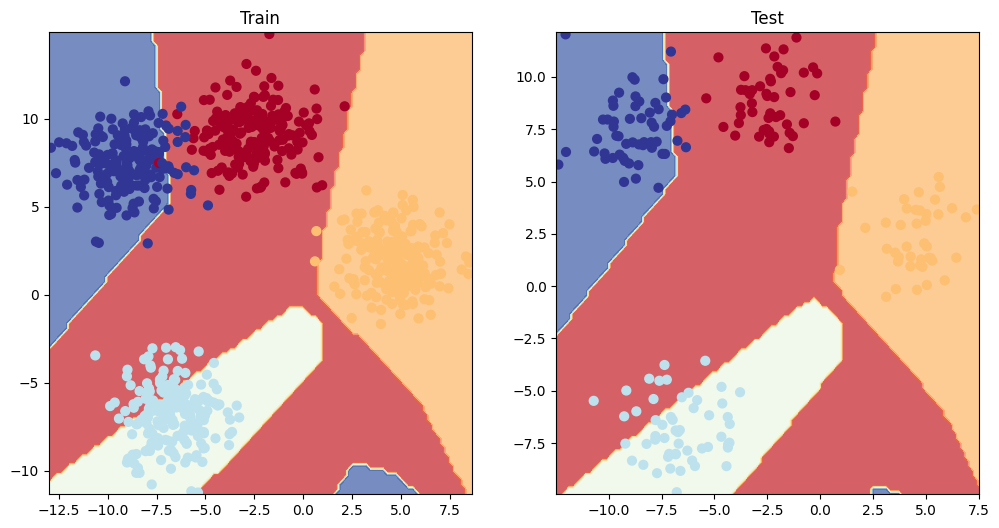

...

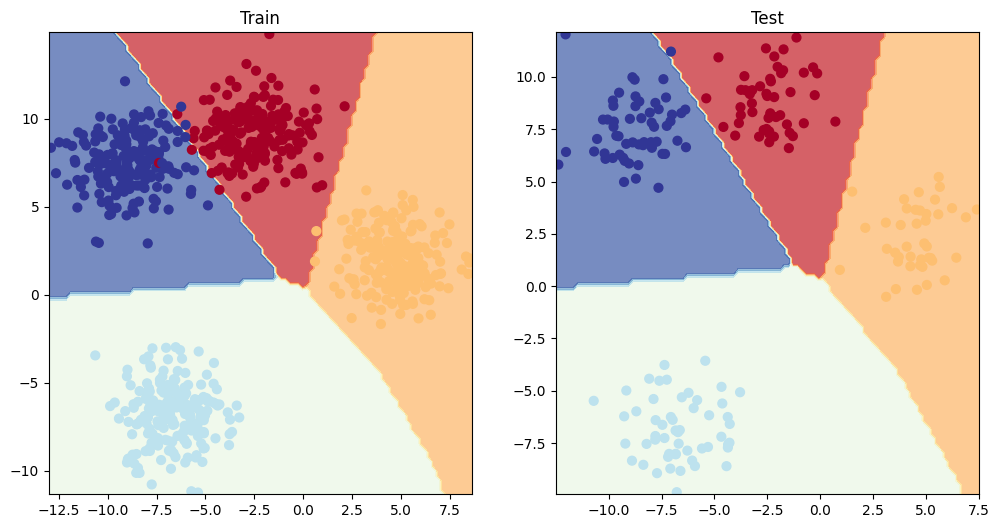

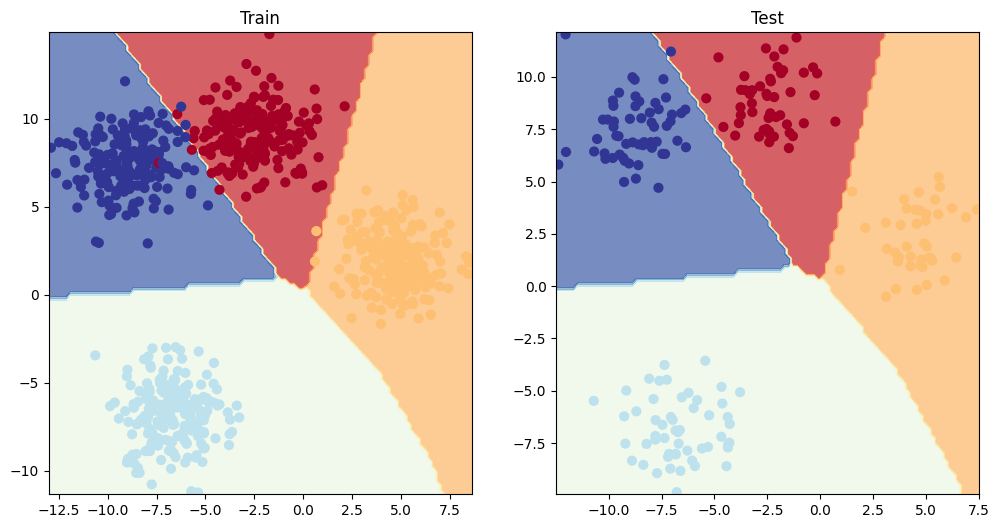

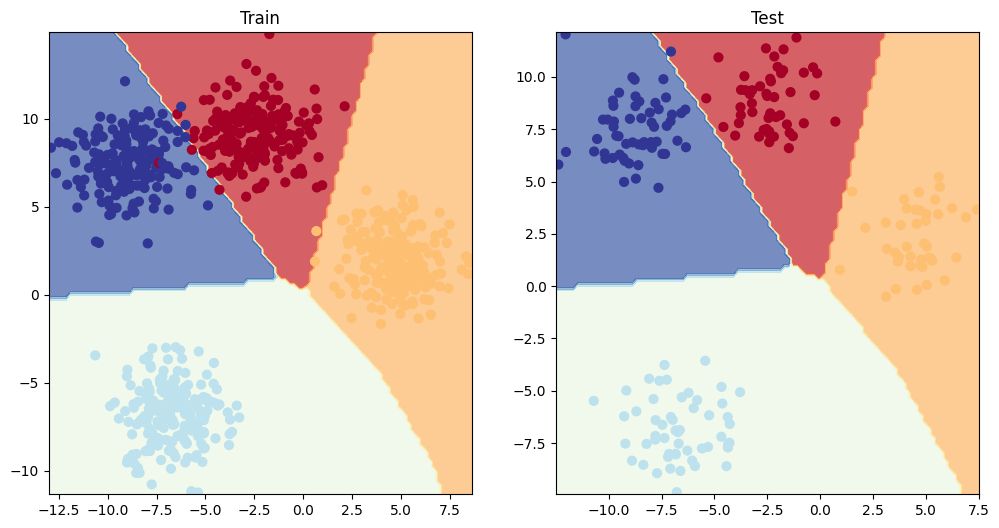

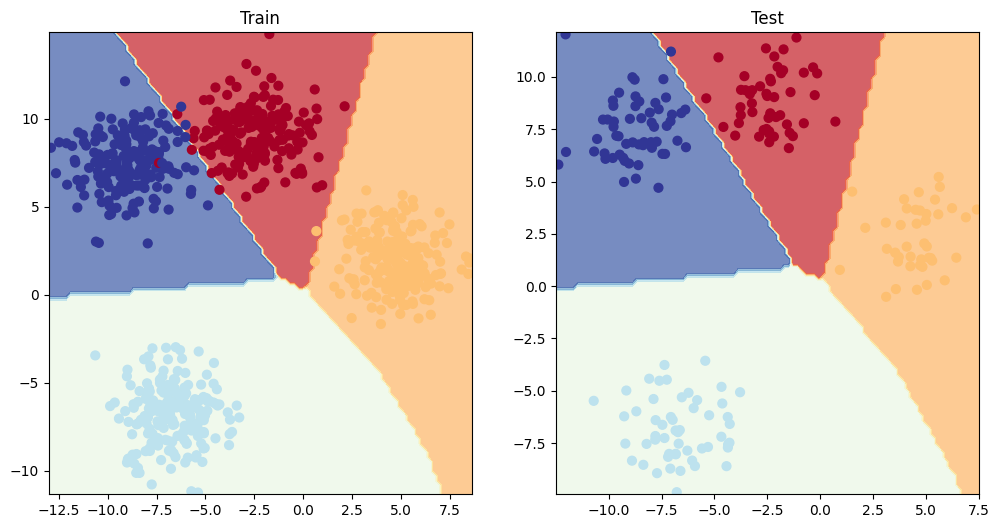

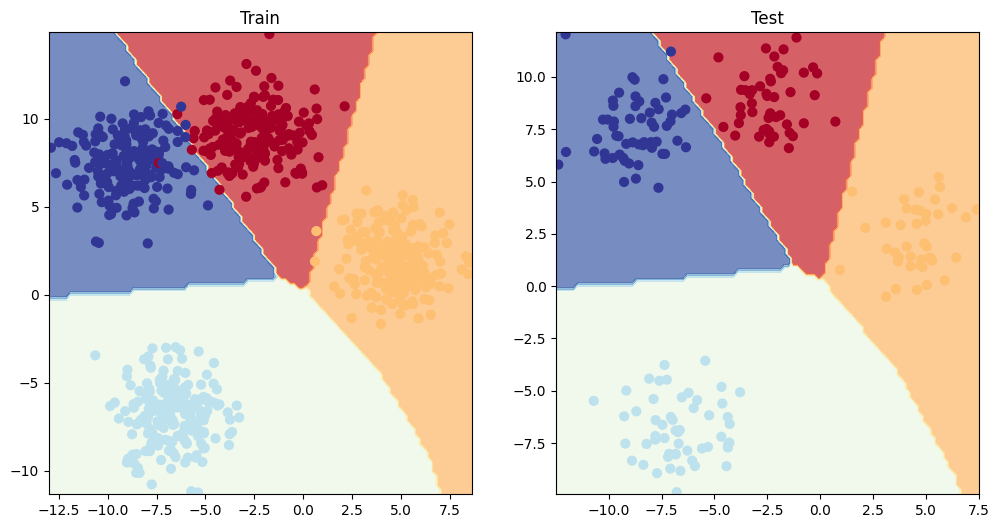

In [136]:
for epoch in range(epochs):
  model_4.train()
  #1. Forward pass
  y_logits=(model_4.to(device))(X_blob_train)
  y_preds = torch.softmax(y_logits, dim=1).argmax(dim=1)
  #2. Calculate loss
  loss = loss_fn(y_logits, y_blob_train)
  accuracy=accuracy_fn(y_true=y_blob_train,
                       y_pred=y_preds)
  optimizer.zero_grad()
  loss.backward()
  optimizer.step()
  ###Training
  model_4.eval()
  with torch.inference_mode():
    y_logits_test=(model_4.to(device))(X_blob_test)
    test_preds=torch.softmax(y_logits_test, dim=1).argmax(dim=1)
  test_loss=loss_fn(y_logits_test, y_blob_test)
  test_accuracy=accuracy_fn(y_true=y_blob_test,
                         y_pred=test_preds)
  if epoch % 1 == 0:
    print(f'Epoch: {epoch} | Loss: {loss:.4f}, Accuracy:{accuracy:.2f}% | Test loss:{test_loss:.4f}, Accuraccy:{test_accuracy:.2f}%')
    plt.figure(figsize=(12,6))
    plt.subplot(1, 2, 1)
    plt.title("Train")
    plot_decision_boundary(model_4, X_blob_train, y_blob_train)
    plt.subplot(1,2,2)
    plt.title("Test")
    plot_decision_boundary(model_4, X_blob_test, y_blob_test)